<a href="https://colab.research.google.com/github/prudvinathmalepati/tutorial_streamlit/blob/test/Credit_Card_Fraud.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pycaret

In [ ]:
#installing seaborn for plotting
!pip install seaborn

In [ ]:
# To display interactive visuals
from pycaret.utils import enable_colab
import matplotlib.pyplot as plt 
enable_colab()

In [ ]:
#we will use pandas for data manipulation
from google.colab import drive

drive.mount('/content/gdrive', force_remount=True)
import pandas as pd
df_path = 'gdrive/My Drive/card_transdata.csv'  #change dir to your project folder
dataset = pd.read_csv(df_path)

In [9]:
#check the shape of the data
dataset.shape

(1000000, 8)

In [10]:
#separating data for modelling and predictions
data = dataset.sample(frac=0.95, random_state=786).reset_index(drop=True)
data_unseen = dataset.drop(data.index).reset_index(drop=True)

print('Data for Modeling: ' + str(data.shape));
print('Unseen data for Predictions: ' + str(data_unseen.shape));

Data for Modeling: (950000, 8)
Unseen data for Predictions: (50000, 8)


In [ ]:
#This had to be installed due to a version mismatch
!pip install numpy 1.20

In [ ]:
#Setting up data
from pycaret.classification import *

In [ ]:
#Setting up data: Step2 : Our target variable is 'fraud' column
credit_card_data = setup(data= data, target='fraud', session_id=1234)

In [ ]:
#installing seaborn for analysis and plotting
!pip install seaborn

In [16]:
data['fraud'].value_counts()

0.0    866962
1.0     83038
Name: fraud, dtype: int64

In [18]:
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [ ]:
# Doing density plots: will be explained in the power point presentation
def plot_numeric(data, numeric_features, target) :
   # Looping through and Plotting Numeric features
    for column in numeric_features:    
        # Figure initiation
        fig = plt.figure(figsize=(18,12))

        ### Distribution plot
        sns.distplot(data[column], ax=plt.subplot(221));
        # X-axis Label
        plt.xlabel(column, fontsize=14);
        # Y-axis Label
        plt.ylabel('Density', fontsize=14);
        # Adding Super Title (One for a whole figure)
        plt.suptitle('Plots for '+column, fontsize=18);

        ### Distribution per False / True class Value
        # False hist
        classes = data[target].unique()
        sns.distplot(data.loc[data[target]==classes[0], column].dropna(),
                     color='red', label=str(classes[0]), ax=plt.subplot(222));
        # True hist
        sns.distplot(data.loc[data[target]==classes[1], column].dropna(),
                     color='blue', label=str(classes[1]), ax=plt.subplot(222));
        # Adding Legend
        plt.legend(loc='best')
        # X-axis Label
        plt.xlabel(column, fontsize=14);
        # Y-axis Label
        plt.ylabel('Density per '+ str(classes[0])+' / '+str(classes[1]), fontsize=14);

        ### Average Column value per True / False Value
        sns.barplot(x=target, y=column, data=data, ax=plt.subplot(223));
        # X-axis Label
        plt.xlabel('Positive or Negative?', fontsize=14);
        # Y-axis Label
        plt.ylabel('Average ' + column, fontsize=14);

        ### Boxplot of Column per True / False class Value
        sns.boxplot(x=target, y=column, data=data, ax=plt.subplot(224));
        # X-axis Label
        plt.xlabel('Positive or Negative ?', fontsize=14);
        # Y-axis Label
        plt.ylabel(column, fontsize=14);
        # Printing Chart
        plt.show

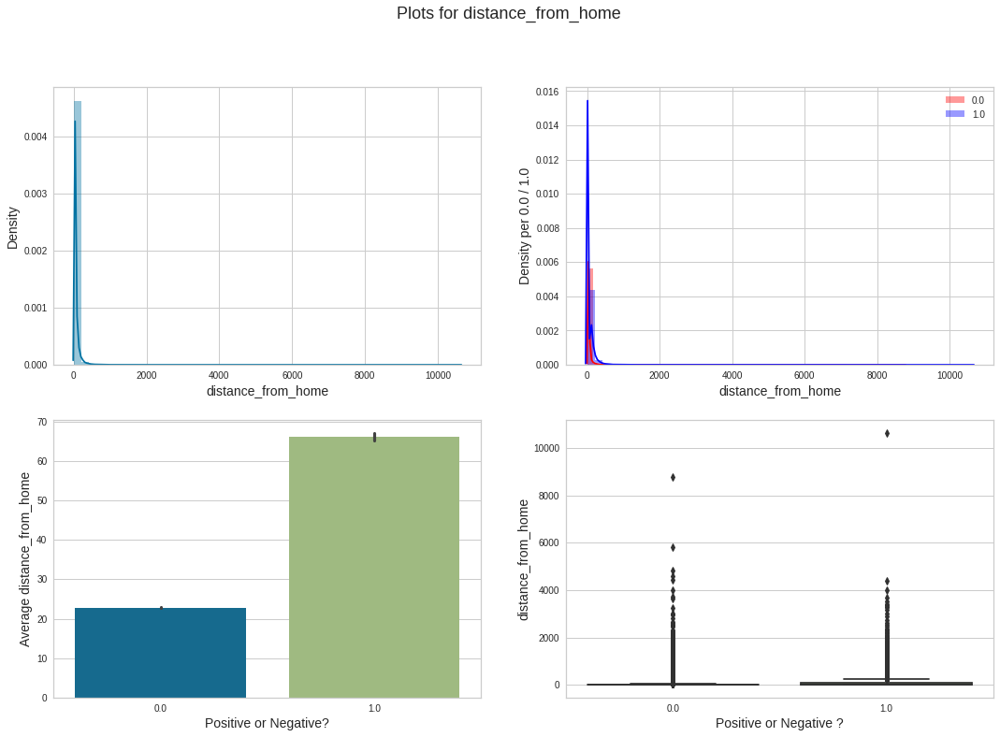

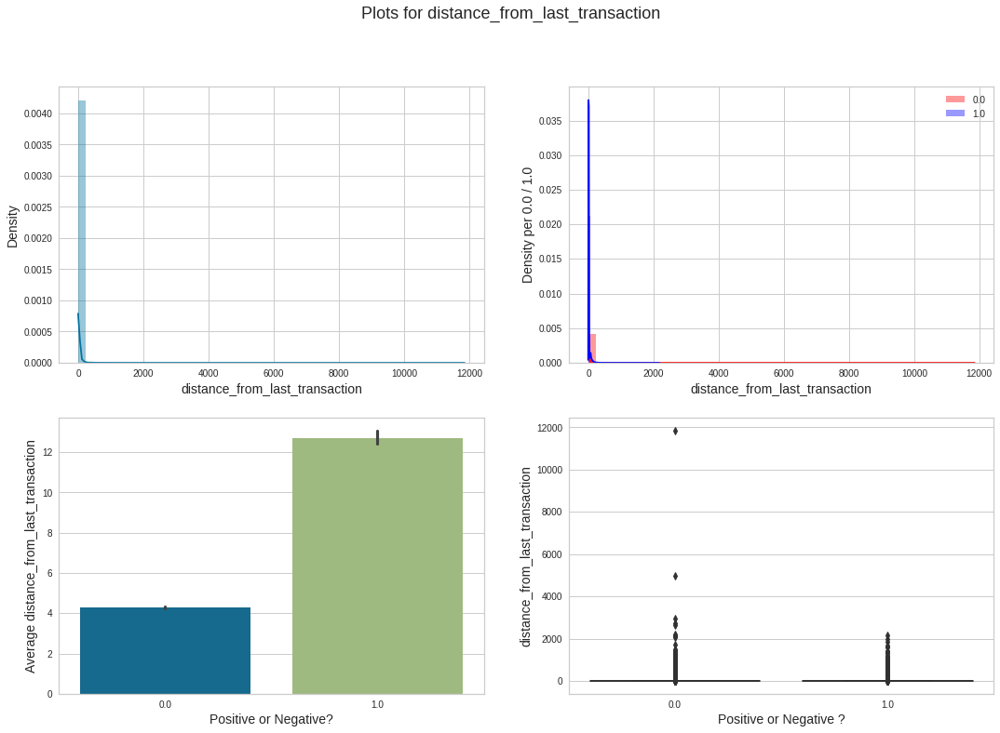

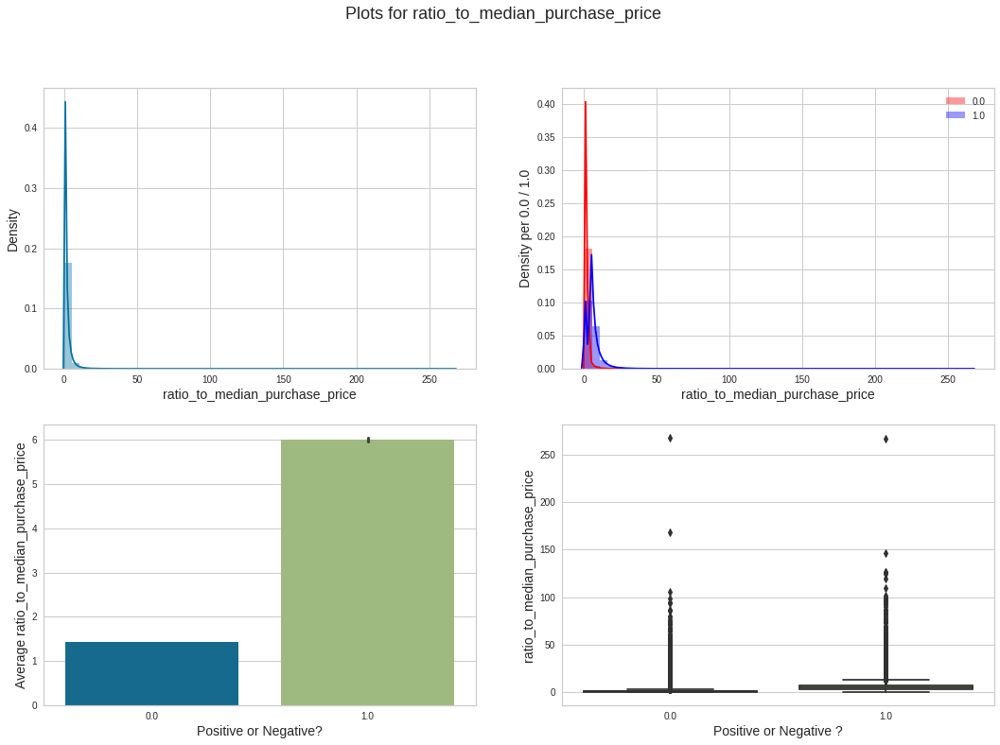

In [22]:
plot_numeric(data,['distance_from_home', 'distance_from_last_transaction',
       'ratio_to_median_purchase_price'] , 'fraud')

In [ ]:
!pip install autoviz

In [24]:
##Doing EDA: This will be used in presentation.
eda(data= data, target="fraud",  display_format= "bokeh")

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
    Since nrows is smaller than dataset, loading random sample of 150000 rows into pandas...
Shape of your Data Set loaded: (150000, 8)
#############################

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
distance_from_home,10000,float64,0,0.000000,100.000000,0,highly skewed: drop outliers or do box-cox transform
distance_from_last_transaction,10000,float64,0,0.000000,100.000000,0,highly skewed: drop outliers or do box-cox transform
ratio_to_median_purchase_price,10000,float64,0,0.000000,100.000000,0,highly skewed: drop outliers or do box-cox transform
repeat_retailer,2,float64,0,0.000000,0.020000,0,skewed: cap or drop outliers
used_chip,2,float64,0,0.000000,0.020000,0,
used_pin_number,2,float64,0,0.000000,0.020000,0,skewed: cap or drop outliers
online_order,2,float64,0,0.000000,0.020000,0,


    7 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Since Number of Rows in data 150000 exceeds maximum, randomly sampling 150000 rows for EDA...

################ Binary_Classification problem #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['distance_from_home', ...], value='distance_from_home')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['distance_from_home', ...], value='distance_from_home')
        [1] Select(name='Y-Axis', options=['distance_from_home', ...], value='distance_from_last_transa...)
        [2] Select(name='Color', options=['None', 'fraud'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['repeat_retailer', ...], value='repeat_retailer', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['distance_from_last_trans...], value='distance_from_last_transa..., width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['repeat_retailer', ...], value='repeat_retailer')
        [1] Select(name='Y-Axis', options=['distance_from_home', ...], value='distance_from_home')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 34


In [ ]:
##Trying to deal outliers with Z-Score method
from scipy.stats import norm
from scipy.stats import multivariate_normal as mn
import numpy as np

def z_score(df, threshold=1):
    mean, std = np.mean(df), np.std(df)
    z_score = np.abs((df - mean) / std)
    good = z_score < threshold
    print(f"z-score of {threshold} corresponds to a prob of {100 * 2 * norm.sf(3):0.2f}%")
    print(f"Rejection {(~good).sum()} points")
    return good

In [26]:
z_score(data['distance_from_home'], threshold=3).sum()

z-score of 3 corresponds to a prob of 0.27%
Rejection 12716 points


937284

z-score of 2 corresponds to a prob of 0.27%
Rejection 23378 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 12716 points
z-score of 4 corresponds to a prob of 0.27%
Rejection 7792 points
z-score of 5 corresponds to a prob of 0.27%
Rejection 5244 points


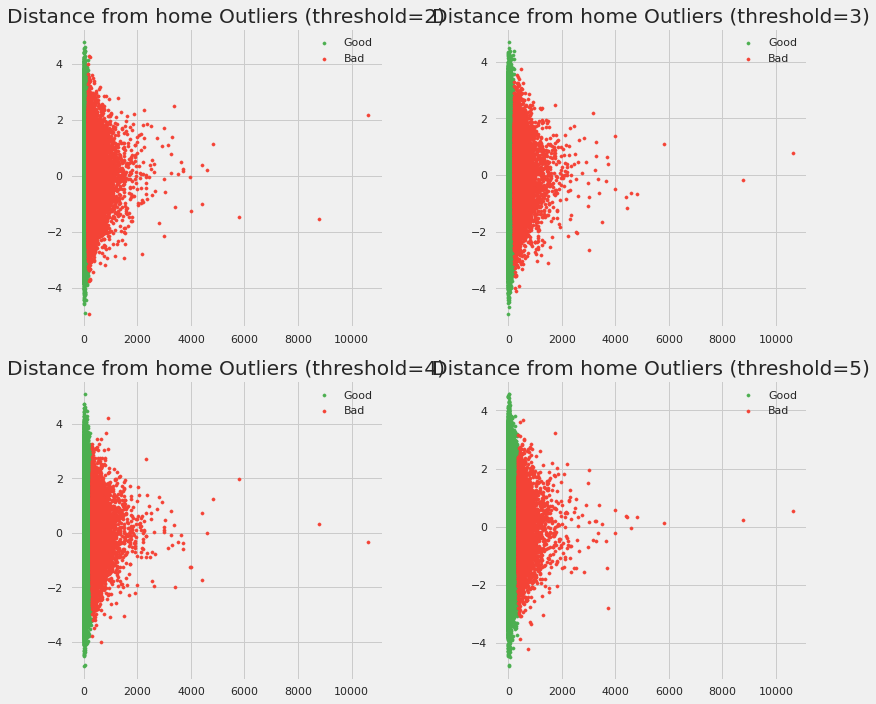

In [27]:
plt.figure(figsize=(12, 10))

for i, threshold in zip(range(1, 5), range(2, 6)):
    plt.subplot(2, 2, i)
    visual_scatter = np.random.normal(size=data.shape[0])
    good = z_score(data['distance_from_home'], threshold=threshold)
    plt.scatter(data['distance_from_home'][good], visual_scatter[good], s=10, label="Good", color="#4CAF50")
    plt.scatter(data['distance_from_home'][~good], visual_scatter[~good], s=10, label="Bad", color="#F44336")
    plt.legend()
    plt.title(f"Distance from home Outliers (threshold={threshold})")

plt.tight_layout()

Note: We created the model using 'Random Classifier Algorithm'. Training, tuning, fitting, saving of the model is done separately and the code for the same can be found on Git Hub.

Important Links:
Github for code: https://github.com/York-ML-Group/group-project-1
App: https://york-ml-group-group-pr-credit-card-fraud-streamlit-final-rv366u.streamlit.app/